<a href="https://colab.research.google.com/github/Ixiondbz/CSE499/blob/main/Copy_of_Cse499.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#@title Import some python packages { vertical-output: true, display-mode: "form" }

%reload_ext autoreload
%autoreload 2
%matplotlib inline

!pip install -U plotly

import json
from pathlib import Path
import plotly
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from tqdm import tqdm
import pandas as pd
import random
import cv2

     |████████████████████████████████| 25.3 MB 1.4 MB/s 
  Attempting uninstall: plotly
    Found existing installation: plotly 4.4.1
    Uninstalling plotly-4.4.1:
      Successfully uninstalled plotly-4.4.1


In [ ]:
from google.colab import drive
drive.mount('/drive')

Mounted at /drive


**Object Detection Packages Installation**

In [ ]:
!pip install object-detection-fastai

     |████████████████████████████████| 316 kB 8.3 MB/s 
     |████████████████████████████████| 60.3 MB 1.3 MB/s 
  Created wheel for openslide-python: filename=openslide_python-1.1.2-cp37-cp37m-linux_x86_64.whl size=27715 sha256=d0d4f6a3b1e21ee06cfe775862e5beaac07bbf9cd11b82cdce241a97dfafe1aa
  Stored in directory: /root/.cache/pip/wheels/6f/c3/97/980962653f9305314bfb6d93f80be5e21f13e206af66fc7ad3
Successfully built openslide-python
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [ ]:
!apt-get install python3-openslide
from openslide import open_slide

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  javascript-common libjs-jquery libopenslide0 python-asn1crypto
  python-blinker python-cffi-backend python-click python-colorama
  python-cryptography python-enum34 python-flask python-idna python-ipaddress
  python-itsdangerous python-jinja2 python-markupsafe
  python-openslide-examples python-openssl python-pkg-resources
  python-pyinotify python-simplejson python-six python-werkzeug
  python3-olefile python3-pil
Suggested packages:
  apache2 | lighttpd | httpd python-blinker-doc python-cryptography-doc
  python-cryptography-vectors python-enum34-doc python-flask-doc
  python-jinja2-doc python-openssl-doc python-openssl-dbg python-setuptools
  python-pyinotify-doc ipython python-genshi python-lxml python-greenlet
  python-redis python-pylibmc | python-memcache python-termcolor
  python-watchdog python-werkzeug-doc python-pil-doc python

In [ ]:

!pip install -U object-detection-fastai

from object_detection_fastai.helper.wsi_loader import *
from object_detection_fastai.loss.RetinaNetFocalLoss import RetinaNetFocalLoss
from object_detection_fastai.models.RetinaNet import RetinaNet
from object_detection_fastai.callbacks.callbacks import BBMetrics, PascalVOCMetricByDistance, PascalVOCMetric, PascalVOCMetricByDistance

In [ ]:
image_folder =  "images"

hamamatsu_rx_ids = list(range(0, 51))
hamamatsu_360_ids = list(range(51, 101))
aperio_ids = list(range(101, 151))
leica_ids = list(range(151, 201))

**seperating datas into scanners**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
annotation_file = "/content/drive/MyDrive/MIDOG_Challenge/MIDOG.json"
rows = []
with open(annotation_file) as f:
    data = json.load(f)

    #categories = {cat["id"]: cat["name"] for cat in data["categories"]}
    categories = {1: 'mitotic figure', 2: 'hard negative'}

    for row in data["images"]:
        file_name = row["file_name"]
        image_id = row["id"]
        width = row["width"]
        height = row["height"]

        scanner  = "Hamamatsu XR"
        if image_id in hamamatsu_360_ids:
            scanner  = "Hamamatsu S360"
        if image_id in aperio_ids:
            scanner  = "Aperio CS"
        if image_id in leica_ids:
            scanner  = "Leica GT450"
         
        for annotation in [anno for anno in data['annotations'] if anno["image_id"] == image_id]:
            box = annotation["bbox"]
            cat = categories[annotation["category_id"]]

            rows.append([file_name, image_id, width, height, box, cat, scanner])

df = pd.DataFrame(rows, columns=["file_name", "image_id", "width", "height", "box", "cat", "scanner"])
df.head()

,file_name,image_id,width,height,box,cat,scanner
0,001.tiff,1,7215,5412,"[4336, 346, 4386, 396]",hard negative,Hamamatsu XR
1,001.tiff,1,7215,5412,"[756, 872, 806, 922]",hard negative,Hamamatsu XR
2,001.tiff,1,7215,5412,"[270, 4044, 320, 4094]",hard negative,Hamamatsu XR
3,001.tiff,1,7215,5412,"[6672.5, 706.5, 6722.5, 756.5]",hard negative,Hamamatsu XR
4,002.tiff,2,7215,5412,"[1872, 319, 1922, 369]",hard negative,Hamamatsu XR


In [ ]:
for scanner in df['scanner'].unique():

    scanner_annos = df[df['scanner'] == scanner]

    row = []
    for image_id in scanner_annos["image_id"].unique():
        image_annos = scanner_annos[scanner_annos["image_id"] == image_id]
        row.append([image_id, len(image_annos[image_annos['cat'] == 'mitotic figure']), "mitotic figure"])
        row.append([image_id, len(image_annos[image_annos['cat'] == 'hard negative']), "hard negative"])

    scanner_meta = pd.DataFrame(row, columns=["image_id", "total", "type"])

    fig = px.bar(scanner_meta, x="image_id", y="total", color="type", title=f"{scanner}: Annotations per image")
    fig.show()

In [ ]:
print('images/f"{image_id:03d}.tiff"')

images/f"{image_id:03d}.tiff"


In [ ]:
os.path.basename(  f"{image_id:03d}.tiff")

'150.tiff'

In [ ]:
cd /content/drive/MyDrive/MIDOG_Challenge/images

/content/drive/.shortcut-targets-by-id/1YUMKNkXUtgaFM6jCHpZxIHPZx_CqE_qG/MIDOG_Challenge/images


In [ ]:
pwd

'/content/drive/.shortcut-targets-by-id/1YUMKNkXUtgaFM6jCHpZxIHPZx_CqE_qG/MIDOG_Challenge/images'

100%|██████████| 40/40 [02:52<00:00,  4.31s/it]



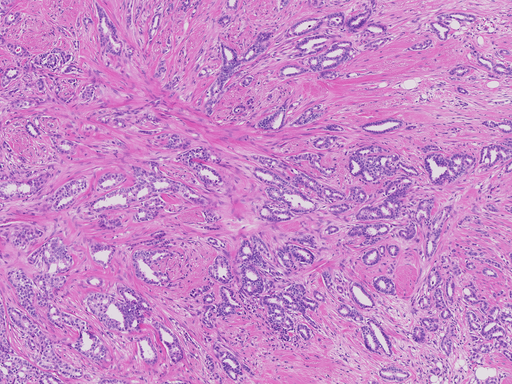
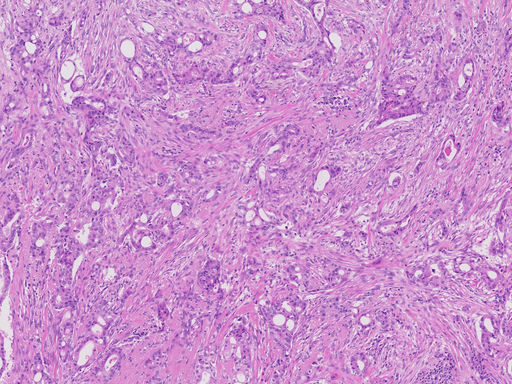
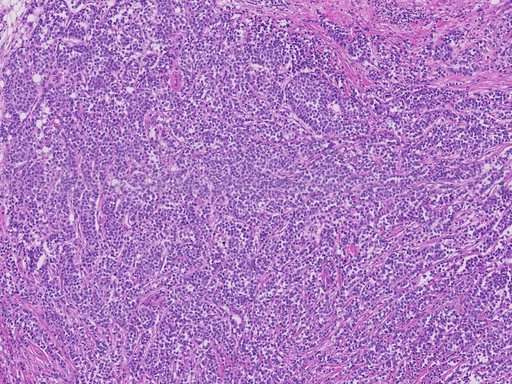
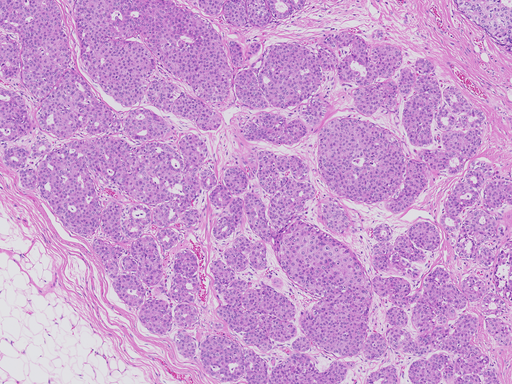
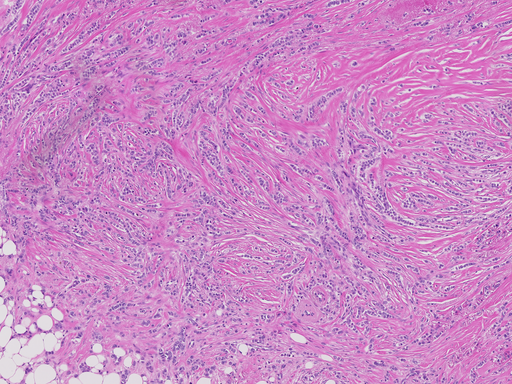
...
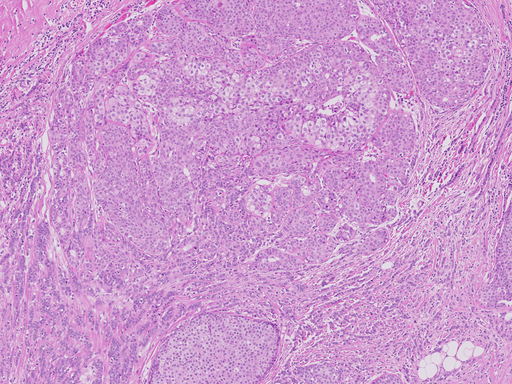
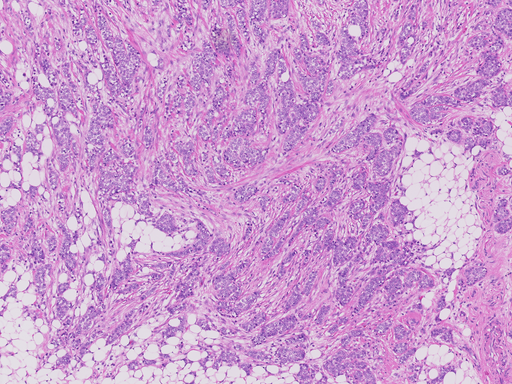
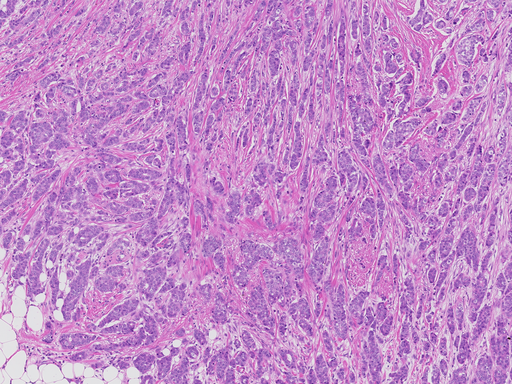
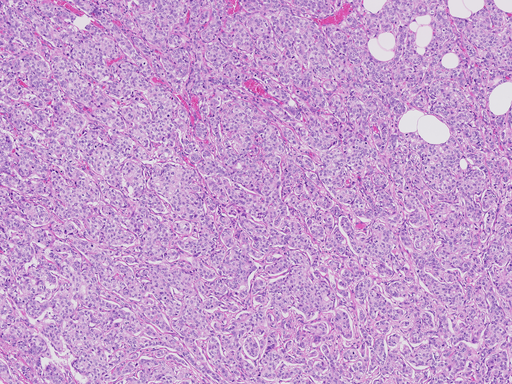
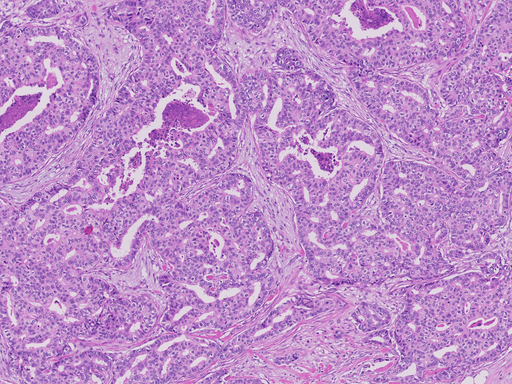

In [ ]:

num_images = 40 #@param {type:"integer"}
thumbail_size =  512#@param {type:"integer"}

for scanner, ids in zip(["Hamamatsu XR"], [hamamatsu_rx_ids]):

    imgs = []

    for image_id in tqdm(ids[:num_images]):

        image_id += 1
        from os import path
        file_path =  f"{image_id:03d}.tiff" 

       
        if path.exists(file_path):
            
            slide = open_slide(str(file_path))
            img = slide.get_thumbnail((thumbail_size, thumbail_size))
            imgs.append(np.array(img))

    imgs = np.array(imgs)

    max_x = max([img.shape[1] for img in imgs])
    max_y = max([img.shape[0] for img in imgs])

    imgs = np.array([cv2.resize(img, dsize=(max_x, max_y)) for img in imgs])

    fig = px.imshow(imgs, facet_col=0, facet_col_wrap=5, labels={'facet_col':'Image'}, title=scanner)

    for i, id in enumerate(ids[:num_images]):
        fig.layout.annotations[i]['text'] = f'Image: {id}'

    fig.show()


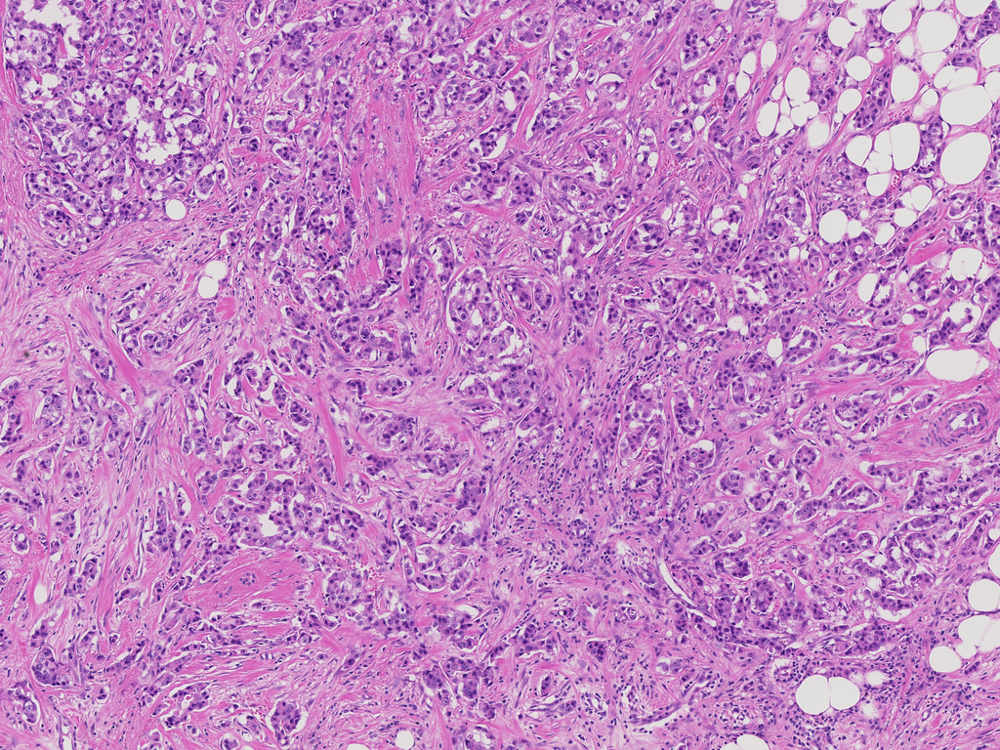

In [ ]:
thumbail_size_big = 1024 #@param {type:"integer"}

#random.choice(hamamatsu_rx_ids)
image_id = 14  #@param {type:"slider", min:1, max:40, step:1}

slide = open_slide(str( f"{image_id:03d}.tiff"))

image = slide.get_thumbnail((thumbail_size_big, thumbail_size_big))

fig = px.imshow(image)

scale_x = slide.level_dimensions[0][0] / image.size[0]
scale_y = slide.level_dimensions[0][1] / image.size[1]

for id, anno in df[df["image_id"] == image_id].iterrows():

    x0, y0, x1, y1 = anno.box[0] / scale_x, anno.box[1] / scale_y, anno.box[2] / scale_x, anno.box[3] / scale_y


    fig.add_shape(
        type='rect',
        x0=x0, x1=x1, y0=y0, y1=y1,
        xref='x', yref='y',
        line_color='red' if "mitotic" in anno["cat"] else "blue"
    )

fig.update_layout(
    autosize=False,
    width=image.size[0],
    height=image.size[1],
    )

fig.show()

**Mitotic Figures**

 12%|█▏        | 6/51 [00:00<00:04,  9.14it/s]



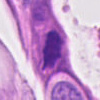
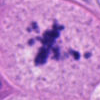
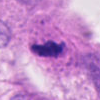
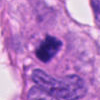
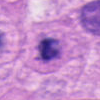
...
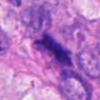
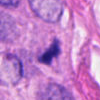
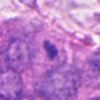
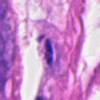
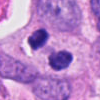

In [ ]:
num_mitotic_figures = 40  #@param {type:"integer"}

for scanner, ids in zip(["Hamamatsu XR"], [hamamatsu_rx_ids]):

    imgs = []
    from os import path
    for image_id in tqdm(ids):

        image_id += 1

        file_path =  f"{image_id:03d}.tiff"

        if path.exists(file_path):
            slide = open_slide(str(file_path))
            annotations = df[(df["file_name"] == f"{image_id:03d}.tiff") & (df["cat"] =="mitotic figure" )]

            for id, anno in annotations.iterrows():

                center_x, center_y = anno.box[0] + (anno.box[2] - anno.box[0]) / 2, anno.box[1] + (anno.box[3] - anno.box[1]) / 2
                img = np.array(slide.read_region((int(center_x-50), int(center_y-50)), level=0, size=(100, 100)))
                imgs.append(img)

                if len(imgs) == num_mitotic_figures:
                    break

        if len(imgs) == num_mitotic_figures:
            break

    fig = px.imshow(np.array(imgs), facet_col=0, facet_col_wrap=5, labels={'facet_col':'mitotic figure'}, title=scanner)
    fig.show()

Hard Negative Figures

  6%|▌         | 3/51 [00:00<00:08,  5.77it/s]



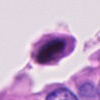
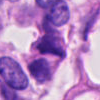
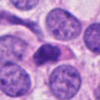
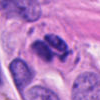
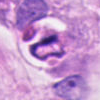
...
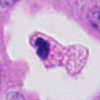
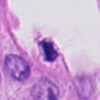
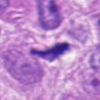
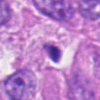
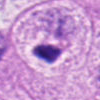

In [ ]:
num_hardNegative_figures = 40  #@param {type:"integer"}

for scanner, ids in zip(["Hamamatsu XR"], [hamamatsu_rx_ids]):

    imgs = []

    for image_id in tqdm(ids):

        image_id += 1
        from os import path
        file_path =  f"{image_id:03d}.tiff"

        if path.exists(file_path):
        
            slide = open_slide(str(file_path))
            annotations = df[(df["file_name"] == f"{image_id:03d}.tiff") & (df["cat"] == "hard negative" )]

            for id, anno in annotations.iterrows():

                center_x, center_y = anno.box[0] + (anno.box[2] - anno.box[0]) / 2, anno.box[1] + (anno.box[3] - anno.box[1]) / 2
                img = np.array(slide.read_region((int(center_x-50), int(center_y-50)), level=0, size=(100, 100)))
                imgs.append(img)

                if len(imgs) == num_hardNegative_figures:
                    break

        if len(imgs) == num_hardNegative_figures:
            break

    fig = px.imshow(np.array(imgs), facet_col=0, facet_col_wrap=5, labels={'facet_col':'hard negative'}, title=scanner)
    fig.show()

In [ ]:
# importing required libraries
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import patches

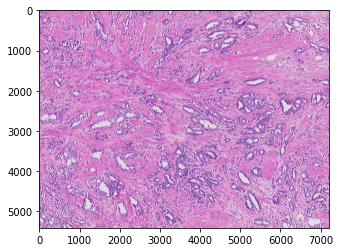

In [ ]:
# reading single image using imread function of matplotlib
image = plt.imread('/content/drive/MyDrive/MIDOG_Challenge/images/001.tiff')
plt.imshow(image)


In [ ]:
df

,file_name,image_id,width,height,box,cat,scanner
0,001.tiff,1,7215,5412,"[4336, 346, 4386, 396]",hard negative,Hamamatsu XR
1,001.tiff,1,7215,5412,"[756, 872, 806, 922]",hard negative,Hamamatsu XR
2,001.tiff,1,7215,5412,"[270, 4044, 320, 4094]",hard negative,Hamamatsu XR
3,001.tiff,1,7215,5412,"[6672.5, 706.5, 6722.5, 756.5]",hard negative,Hamamatsu XR
4,002.tiff,2,7215,5412,"[1872, 319, 1922, 369]",hard negative,Hamamatsu XR
...,...,...,...,...,...,...,...
4430,150.tiff,150,6467,4862,"[569, 4276, 619, 4326]",hard negative,Aperio CS
4431,150.tiff,150,6467,4862,"[3730, 4538, 3780, 4588]",mitotic figure,Aperio CS
4432,150.tiff,150,6467,4862,"[4318, 4138, 4368, 4188]",hard negative,Aperio CS
4433,150.tiff,150,6467,4862,"[5643, 1318, 5693, 1368]",hard negative,Aperio CS


In [ ]:
df.dtypes

file_name    object
image_id      int64
width         int64
height        int64
box          object
cat          object
scanner      object
dtype: object

In [ ]:
import ast
#df['box'] = df['box'].apply(lambda x: ast.literal_eval(x))
x=np.array(list(df['box']))

for i,dim in enumerate([ 'xmin', 'ymin', 'xmax', 'ymax' ]):
	df[dim] = x[:, i]

df.drop('box', axis=1, inplace=True)
df.head()

,file_name,image_id,width,height,cat,scanner,xmin,ymin,xmax,ymax
0,001.tiff,1,7215,5412,hard negative,Hamamatsu XR,4336.0,346.0,4386.0,396.0
1,001.tiff,1,7215,5412,hard negative,Hamamatsu XR,756.0,872.0,806.0,922.0
2,001.tiff,1,7215,5412,hard negative,Hamamatsu XR,270.0,4044.0,320.0,4094.0
3,001.tiff,1,7215,5412,hard negative,Hamamatsu XR,6672.5,706.5,6722.5,756.5
4,002.tiff,2,7215,5412,hard negative,Hamamatsu XR,1872.0,319.0,1922.0,369.0


In [ ]:
dpi = 80
height, width, depth = image.shape
figsize = width / float(dpi), height / float(dpi)

In [ ]:
train=df

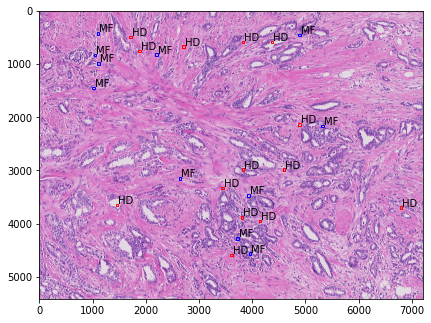

In [ ]:
fig = plt.figure()

#add axes to the image
ax = fig.add_axes([0,0,1,1])

#plot the image
plt.imshow(image)

# iterating over the image for different objects
for _,row in train[train.file_name == "003.tiff"].iterrows():
    xmin = row.xmin
    ymin = row.ymin
    xmax = row.xmax
    ymax = row.ymax
    
    width = xmax - xmin
    height = ymax - ymin
    
    # assign different color to different classes of objects
    if row['cat'] == "hard negative":
        edgecolor = 'r'
        ax.annotate("HD", xy=(xmax,ymin))
    elif row['cat'] == "mitotic figure":
        edgecolor = 'b'
        ax.annotate("MF", xy=(xmax,ymin))
        
   # add bounding boxes to the image
    rect = patches.Rectangle((xmin,ymin), width, height, edgecolor = edgecolor, facecolor = 'none')
     
    ax.add_patch(rect)

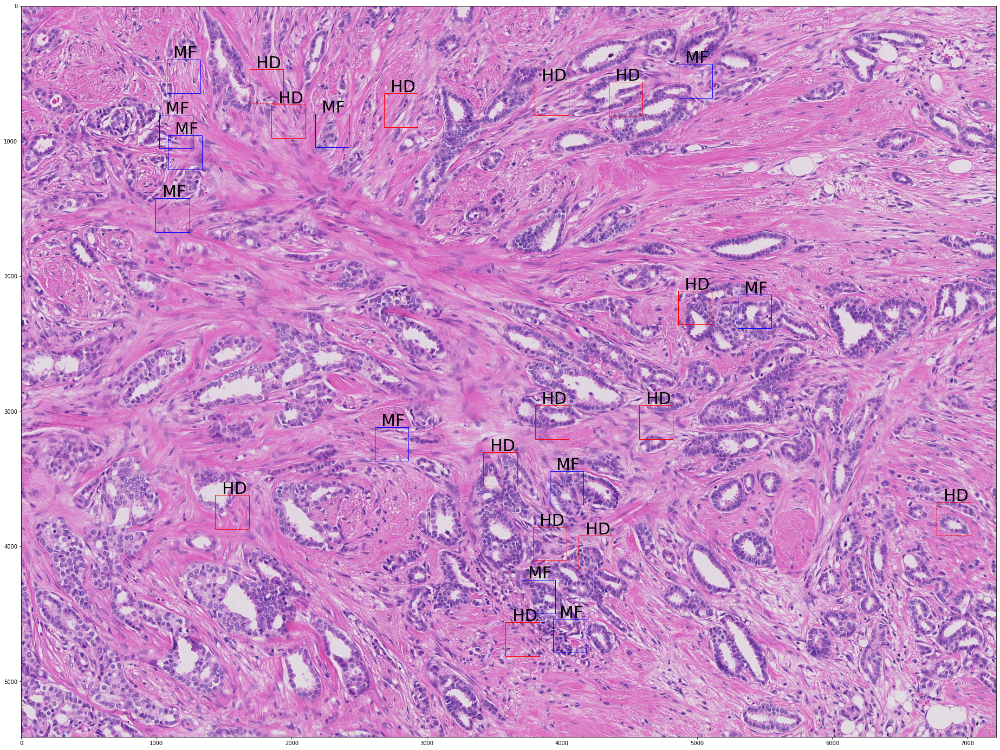

In [ ]:

fig = plt.figure(figsize=(25,20))

#add axes to the image
ax = fig.add_axes([0,0,1,1])

#plot the image
plt.imshow(image)

# iterating over the image for different objects
for _,row in train[train.file_name == "003.tiff"].iterrows():
    xmin = row.xmin
    ymin = row.ymin
    xmax = row.xmax
    ymax = row.ymax
    
    width = xmax - xmin
    height = ymax - ymin
    
    # assign different color to different classes of objects
    if row['cat'] == "hard negative":
        edgecolor = 'r'
        text = ax.annotate("HD", xy=(xmax,ymin-10))
        text.set_fontsize(30)
    elif row['cat'] == "mitotic figure":
        edgecolor = 'b'
        text = ax.annotate("MF",  xy=(xmax,ymin-10))
        text.set_fontsize(30)
        
   # add bounding boxes to the image
    rect = patches.Rectangle((xmin,ymin), width+200, height+200,   edgecolor = edgecolor, facecolor = 'none')
     
    ax.add_patch(rect)